### Imports


In [33]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sqlite3 as sql
import numpy as np
import warnings
from pandas.api.types import is_numeric_dtype
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler, LabelEncoder
from sklearn.compose import make_column_transformer, ColumnTransformer
from sklearn.linear_model import LinearRegression, Ridge, ElasticNet, Lasso 
from sklearn.model_selection import cross_val_score
from sklearn.impute import SimpleImputer
from sklearn.model_selection import GridSearchCV
from collections import OrderedDict
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor 
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.linear_model import ElasticNetCV, LassoCV, RidgeCV
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler, LabelEncoder, RobustScaler
from sklearn.compose import make_column_transformer, ColumnTransformer
from sklearn.linear_model import LinearRegression, Ridge, ElasticNet, Lasso 
from sklearn.model_selection import cross_val_score, KFold
from sklearn.impute import SimpleImputer
from sklearn.model_selection import GridSearchCV
from collections import OrderedDict
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor 
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.cluster import KMeans
from xgboost import XGBRegressor
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import KMeans
import scipy.stats as stats
import json
import requests

warnings.filterwarnings('ignore')



### File directory 

In [34]:
main_data_path = "../../data/main_data/main_data.db"

In [35]:

con = sql.connect(main_data_path)

pg_stats = pd.read_sql("""SELECT *
                            FROM player_stats""",con)

con.close()



In [36]:
test=pg_stats[(pg_stats['season'] == '23/24') & (pg_stats['league'] == 'Premier League')]
test

,name,shortName,position_acronym,height,date_of_birth_ss,team,date,league,season,minutesPlayed,...,height_in_cm,transfered,transfered_from,transfered_to,transfer_fee,market_value_in_eur,yellow_card,red_card,xGChain,xGBuildup
831437,jordan beyer,J. Beyer,D,187.0,2000-05-18 17:00:00,Burnley,2023-08-11,Premier League,23/24,74,...,187.0,yes,Borussia Verein für Leibesübungen 1900 Mönchen...,Burnley FC,15000000.0,16000000.0,0.0,0.0,0.000000,0.000000
831438,luca koleosho,L. Koleosho,M,175.0,2004-09-14 17:00:00,Burnley,2023-08-11,Premier League,23/24,61,...,175.0,no,Burnley FC,Burnley FC,0.0,1000000.0,0.0,0.0,0.216929,0.000000
831439,dara o'shea,D. O'Shea,D,188.0,1999-03-03 16:00:00,Burnley,2023-08-11,Premier League,23/24,90,...,189.0,yes,West Bromwich Albion,Burnley FC,7800000.0,5000000.0,0.0,0.0,0.000000,0.000000
831440,sander berge,S. Berge,M,195.0,1998-02-13 16:00:00,Burnley,2023-08-11,Premier League,23/24,89,...,195.0,yes,Sheffield United,Burnley FC,13900000.0,20000000.0,0.0,0.0,0.058055,0.058055
831441,aymeric laporte,A. Laporte,D,191.0,1994-05-26 17:00:00,Manchester City,2023-08-11,Premier League,23/24,11,...,191.0,no,Manchester City Football Club,Manchester City Football Club,0.0,25000000.0,0.0,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
933903,jack grealish,J. Grealish,M,180.0,1995-09-09 17:00:00,Manchester City,2024-05-19,Premier League,23/24,0,...,180.0,no,Manchester City Football Club,Manchester City Football Club,0.0,60000000.0,0.0,0.0,0.000000,0.000000
933904,matheus nunes,M. Nunes,M,183.0,1998-08-26 17:00:00,Manchester City,2024-05-19,Premier League,23/24,0,...,183.0,no,Manchester City Football Club,Manchester City Football Club,0.0,50000000.0,0.0,0.0,0.000000,0.000000
933905,rico lewis,R. Lewis,M,170.0,2004-11-20 16:00:00,Manchester City,2024-05-19,Premier League,23/24,0,...,169.0,no,Manchester City Football Club,Manchester City Football Club,0.0,38000000.0,0.0,0.0,0.000000,0.000000
933906,konstantinos mavropanos,K. Mavropanos,D,194.0,1997-12-10 16:00:00,West Ham United,2024-05-19,Premier League,23/24,90,...,194.0,no,West Ham United Football Club,West Ham United Football Club,0.0,20000000.0,0.0,0.0,0.000000,0.000000


### This is all the stats
But this is not as useful to see what kind of data we have

In [37]:
pg_stats


,name,shortName,position_acronym,height,date_of_birth_ss,team,date,league,season,minutesPlayed,...,height_in_cm,transfered,transfered_from,transfered_to,transfer_fee,market_value_in_eur,yellow_card,red_card,xGChain,xGBuildup
0,declan john,D. John,D,178.0,1995-06-29 17:00:00,Cardiff City,2014-08-08,Championship,14/15,0,...,178.0,no,Rangers Football Club,Rangers Football Club,0.0,500000.0,0.0,0.0,0.0,0.0
1,rudy gestede,R. Gestede,F,193.0,1988-10-09 17:00:00,Blackburn Rovers,2014-08-08,Championship,14/15,0,...,193.0,no,Panetolikos Agrinio,Panetolikos Agrinio,0.0,1500000.0,0.0,0.0,0.0,0.0
2,jordan rhodes,J. Rhodes,F,185.0,1990-02-04 16:00:00,Blackburn Rovers,2014-08-08,Championship,14/15,0,...,185.0,no,Middlesbrough FC,Middlesbrough FC,0.0,10000000.0,0.0,0.0,0.0,0.0
3,craig conway,C. Conway,F,170.0,1985-05-01 17:00:00,Blackburn Rovers,2014-08-08,Championship,14/15,0,...,171.0,no,Saint Johnstone Football Club,Saint Johnstone Football Club,0.0,1000000.0,0.0,0.0,0.0,0.0
4,tom cairney,T. Cairney,M,185.0,1991-01-19 16:00:00,Blackburn Rovers,2014-08-08,Championship,14/15,0,...,185.0,no,Fulham Football Club,Fulham Football Club,0.0,2000000.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
961306,bobby thomas,B. Thomas,D,186.0,2001-01-29 16:00:00,Coventry City,2024-10-22,Championship,24/25,90,...,186.0,no,Burnley FC,Burnley FC,0.0,2000000.0,0.0,0.0,0.0,0.0
961307,joel latibeaudiere,J. Latibeaudiere,D,180.0,2000-01-05 16:00:00,Coventry City,2024-10-22,Championship,24/25,90,...,180.0,no,Football Club Twente,Football Club Twente,0.0,1000000.0,0.0,0.0,0.0,0.0
961308,nicolas madsen,N. Madsen,M,193.0,2000-03-16 16:00:00,Queens Park Rangers,2024-10-22,Championship,24/25,0,...,192.0,no,Koninklijke Voetbal Club Westerlo,Koninklijke Voetbal Club Westerlo,0.0,2500000.0,0.0,0.0,0.0,0.0
961309,harrison ashby,H. Ashby,D,179.0,2001-11-13 16:00:00,Queens Park Rangers,2024-10-22,Championship,24/25,10,...,179.0,yes,Swansea City,Newcastle United Football Club,0.0,1200000.0,0.0,0.0,0.0,0.0


In [38]:
pg_stats.columns

Index(['name', 'shortName', 'position_acronym', 'height', 'date_of_birth_ss',
       'team', 'date', 'league', 'season', 'minutesPlayed', 'rating',
       'accuratePass', 'totalLongBalls', 'accurateLongBalls', 'keyPass',
       'totalPass', 'totalCross', 'accurateCross', 'goalAssist',
       'savedShotsFromInsideTheBox', 'saves', 'totalKeeperSweeper',
       'accurateKeeperSweeper', 'goalsPrevented', 'touches',
       'possessionLostCtrl', 'dispossessed', 'expectedAssists', 'aerialLost',
       'aerialWon', 'duelLost', 'duelWon', 'challengeLost', 'outfielderBlock',
       'totalContest', 'interceptionWon', 'wonContest', 'totalTackle',
       'totalClearance', 'blockedScoringAttempt', 'hitWoodwork',
       'bigChanceCreated', 'bigChanceMissed', 'shotOffTarget',
       'onTargetScoringAttempt', 'goals', 'expectedGoals', 'wasFouled',
       'fouls', 'totalOffside', 'first_name', 'last_name', 'date_of_birth',
       'sub_position', 'position_full', 'foot', 'height_in_cm', 'transfered',
   

In [39]:
p_stats = ['name', 'shortName', 'position_acronym', 'height','foot', 'date_of_birth_ss',
       'team', 'date', 'league', 'season']
g_stats = ['age','season','league','height','foot','minutesPlayed','rating',
       'accuratePass', 'totalLongBalls', 'accurateLongBalls', 'keyPass',
       'totalPass', 'totalCross', 'accurateCross','goalAssist',
       'savedShotsFromInsideTheBox', 'saves', 'totalKeeperSweeper',
       'accurateKeeperSweeper', 'goalsPrevented', 'touches',
       'possessionLostCtrl', 'dispossessed', 'expectedAssists','aerialLost',
       'aerialWon', 'duelLost', 'duelWon', 'challengeLost',
       'outfielderBlock','totalContest', 'interceptionWon', 'totalContest',
       'wonContest', 'totalTackle', 'totalClearance', 'blockedScoringAttempt',
       'hitWoodwork', 'bigChanceCreated', 'bigChanceMissed', 'shotOffTarget',
       'onTargetScoringAttempt', 'goals', 'expectedGoals', 'wasFouled',
       'fouls', 'totalOffside','yellow_card','red_card','xGChain','xGBuildup']

g_stats_count = [
    'minutesPlayed', 'totalLongBalls', 'keyPass','accuratePass',
       'totalPass', 'totalCross',
       'savedShotsFromInsideTheBox', 'saves', 'totalKeeperSweeper', 'goalsPrevented', 'touches',
       'possessionLostCtrl', 'dispossessed','goalAssist',
       'aerialWon','aerialLost', 'duelLost', 'duelWon', 'challengeLost',
       'outfielderBlock','totalContest', 'interceptionWon', 'totalContest','accurateCross','goalAssist','accurateKeeperSweeper',
       'accurateLongBalls',
       'wonContest', 'totalTackle', 'totalClearance', 'blockedScoringAttempt',
       'hitWoodwork', 'bigChanceCreated', 'bigChanceMissed', 'shotOffTarget',
       'onTargetScoringAttempt', 'goals', 'wasFouled',
       'fouls', 'totalOffside','yellow_card','red_card']


g_stats_ex = ['expectedGoals','expectedAssists','rating','xGChain','xGBuildup']


t_stats = ['transfered',
       'transfered_from', 'transfered_to', 'transfer_fee',
       'market_value_in_eur']



### Check for missing data

In [40]:
missing = pg_stats.isnull().sum()
missing = missing[missing>0]
missing.sort_values(inplace=True)
missing

Series([], dtype: int64)

In [41]:
condition = True
for i, gs in enumerate(g_stats):
    if gs not in ['age','season','league','height','foot','minutesPlayed']:
        condition = condition & (pg_stats[gs]==0)
remove_stats = pg_stats[condition]
remove_stats
pg_stats = pg_stats[~condition]

### Get avgs and Counts per Season

In [42]:
def identity(x):
    return x.iloc[0]

agg_dict = {}
for gc in g_stats_count:
    agg_dict[gc] = 'sum'

for gc in g_stats_ex:
    agg_dict[gc] = 'mean'

agg_dict['market_value_in_eur'] = 'max'
agg_dict['position_acronym'] = identity
agg_dict['league'] = identity
agg_dict['season'] = identity
agg_dict['team'] = identity
agg_dict['date'] = 'max'
agg_dict['date_of_birth_ss'] = identity
agg_dict['height'] = identity
agg_dict['foot'] = identity



per_season = pg_stats.groupby(['name','season']).agg(agg_dict, as_index=False)



In [43]:
per_season['date'] = pd.to_datetime(per_season['date'])
per_season['date_of_birth_ss'] = pd.to_datetime(per_season['date_of_birth_ss'])

per_season['age'] = np.floor((per_season['date'] - per_season['date_of_birth_ss']).dt.days/365)
per_season

minutesPlayed  totalLongBalls  keyPass  accuratePass  \
name            season                                                         
aaron bastiaans 19/20              16               0        0             0   
                20/21              22               1        0             4   
aaron connolly  19/20            1266               2        6           113   
                20/21             799               1        6            72   
                21/22            1342              10        8           125   
...                               ...             ...      ...           ...   
zé manuel       23/24             613               8        8           113   
zé paulo        15/16              41               3        0             8   
zé pedro        23/24             929              82        2           680   
                24/25             630              45        3           448   
zé turbo        16/17             152               2        2            20   

                        totalPass  totalCross  savedShotsFromInsideTheBox  \
name            season                                                      
aaron bastiaans 19/20           0           0                           0   
                20/21           7           0                           0   
aaron connolly  19/20         146           9                           0   
                20/21          92           2                           0   
                21/22         175           1                           0   
...                           ...         ...                         ...   
zé manuel       23/24         149          10                           0   
zé paulo        15/16          15           0                           0   
zé pedro        23/24         761           4                           0   
                24/25         522           3                           0   
zé turbo        16/17          29           2                           0   

                        saves  totalKeeperSweeper  goalsPrevented  ...  \
name            season                                             ...   
aaron bastiaans 19/20       0                   0             0.0  ...   
                20/21       0                   0             0.0  ...   
aaron connolly  19/20       0                   0             0.0  ...   
                20/21       0                   0             0.0  ...   
                21/22       0                   0             0.0  ...   
...                       ...                 ...             ...  ...   
zé manuel       23/24       0                   0             0.0  ...   
zé paulo        15/16       0                   0             0.0  ...   
zé pedro        23/24       0                   0             0.0  ...   
                24/25       0                   0             0.0  ...   
zé turbo        16/17       0                   0             0.0  ...   

                        market_value_in_eur  position_acronym  \
name            season                                          
aaron bastiaans 19/20              150000.0                 F   
                20/21              150000.0                 F   
aaron connolly  19/20             7000000.0                 F   
                20/21             7000000.0                 F   
                21/22             7000000.0                 F   
...                                     ...               ...   
zé manuel       23/24              100000.0                 F   
zé paulo        15/16              250000.0                 M   
zé pedro        23/24             3000000.0                 D   
                24/25             3000000.0                 D   
zé turbo        16/17              300000.0                 F   

                                       league  season                    team  \
name            season                                                          
aaron bast

In [44]:
per_season.loc['declan rice']

,minutesPlayed,totalLongBalls,keyPass,accuratePass,totalPass,totalCross,savedShotsFromInsideTheBox,saves,totalKeeperSweeper,goalsPrevented,...,market_value_in_eur,position_acronym,league,season,team,date,date_of_birth_ss,height,foot,age
season,,,,,,,,,,,,,,,,,,,,,
16/17,1,0,0,6,6,0,0,0,0,0.0,...,500000.0,M,Premier League,16/17,West Ham United,2017-05-21,1999-01-13 16:00:00,188.0,right,18.0
17/18,1423,111,2,451,573,5,0,0,0,0.0,...,10000000.0,M,Premier League,17/18,West Ham United,2018-05-13,1999-01-13 16:00:00,188.0,right,19.0
18/19,3004,144,9,1312,1518,3,0,0,0,0.0,...,45000000.0,M,Premier League,18/19,West Ham United,2019-05-12,1999-01-13 16:00:00,188.0,right,20.0
19/20,3420,215,21,1491,1733,28,0,0,0,0.0,...,55000000.0,M,Premier League,19/20,West Ham United,2020-07-26,1999-01-13 16:00:00,188.0,right,21.0
20/21,2879,121,23,1343,1526,30,0,0,0,0.0,...,65000000.0,M,Premier League,20/21,West Ham United,2021-05-23,1999-01-13 16:00:00,188.0,right,22.0
21/22,3178,174,24,1973,2153,30,0,0,0,0.0,...,80000000.0,M,Premier League,21/22,West Ham United,2022-05-22,1999-01-13 16:00:00,188.0,right,23.0
22/23,3278,222,37,1833,2082,44,0,0,0,0.0,...,90000000.0,M,Premier League,22/23,West Ham United,2023-05-28,1999-01-13 16:00:00,188.0,right,24.0
23/24,3230,141,47,2019,2227,60,0,0,0,0.0,...,120000000.0,M,Premier League,23/24,Arsenal,2024-05-19,1999-01-13 16:00:00,188.0,right,25.0
24/25,584,18,10,239,264,38,0,0,0,0.0,...,120000000.0,M,Premier League,24/25,Arsenal,2024-10-19,1999-01-13 16:00:00,188.0,right,25.0


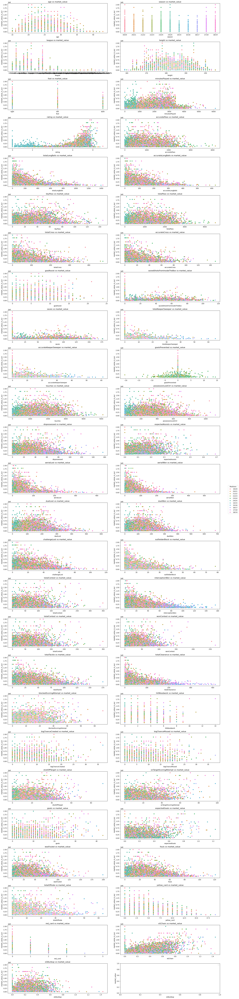

In [45]:
fig,axes = plt.subplots(ncols=2,nrows = int(len(g_stats)/2)+1,figsize=(20,90))
axes = axes.flatten()

for i, gs in enumerate(g_stats):
    
    sns.scatterplot(data=per_season,x=gs,y='market_value_in_eur',hue='season',ax=axes[i])
    axes[i].set_title(f'{gs} vs market_value')
    axes[i].legend().remove()
    plt.xlabel(gs)
    plt.ylabel('market_value')

handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1.02, 0.5), title='Positions')
plt.tight_layout()
plt.legend()
plt.show()

<Axes: xlabel='market_value_in_eur', ylabel='Count'>

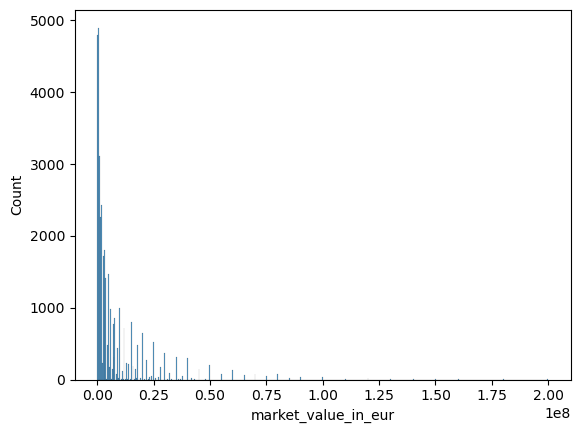

In [46]:
sns.histplot(data=per_season,x='market_value_in_eur')

In [47]:
# Skewness and Kurtosis
print(f'Skewness: {per_season['market_value_in_eur'].skew()}')
print(f'Kurtosis: {per_season['market_value_in_eur'].kurt()}')

Skewness: 4.5304161381550125
Kurtosis: 31.57942059073085


### Outlier analysis

In [48]:
def reject_outliers(data,column,m=3):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    return data[(data[column] < (Q3 + m*IQR))]

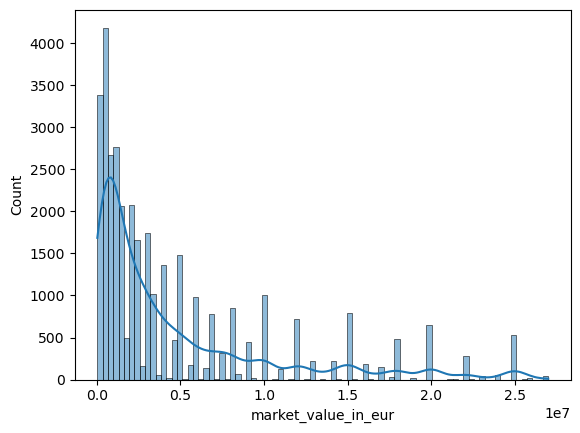

In [49]:
reject= reject_outliers(per_season,'market_value_in_eur',m=3)

sns.histplot(data=reject,x='market_value_in_eur',kde=True)
plt.show()

In [50]:
data_loss = per_season['market_value_in_eur'].shape[0] - reject_outliers(per_season,'market_value_in_eur',m=3).shape[0]
print(f'lose {data_loss} out of {per_season['market_value_in_eur'].shape[0]}')

lose 2342 out of 37300


### Normality Analysis of Target Variable

1.4718235520313585 1.041440600779309


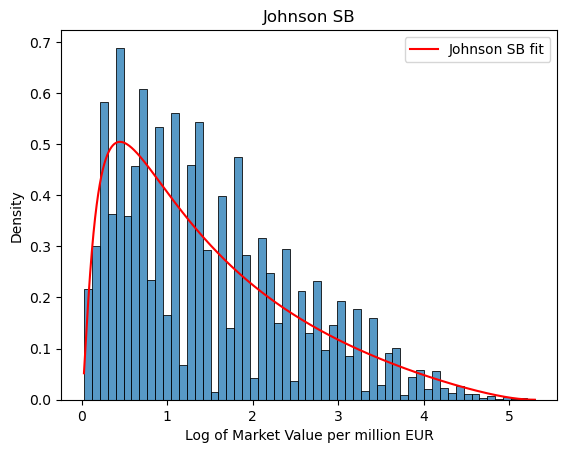

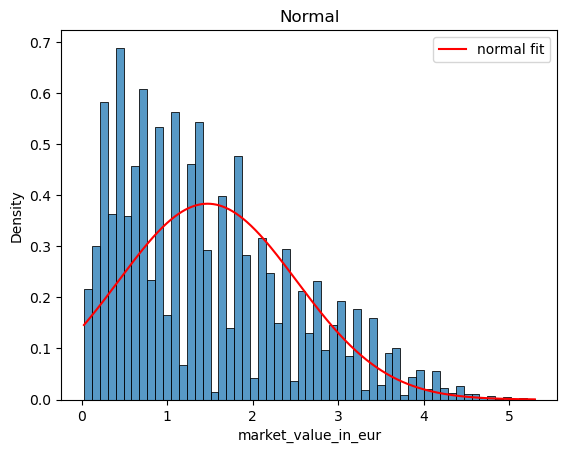

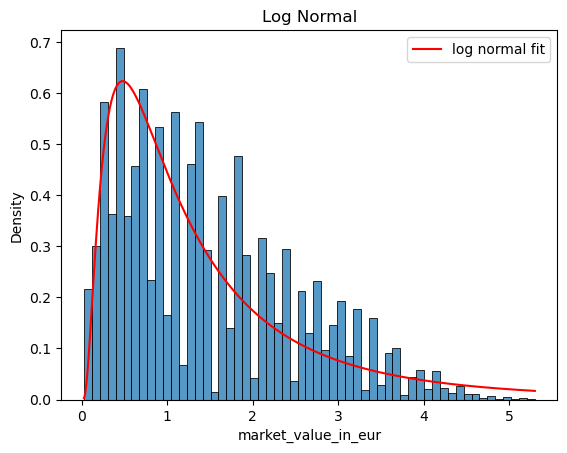

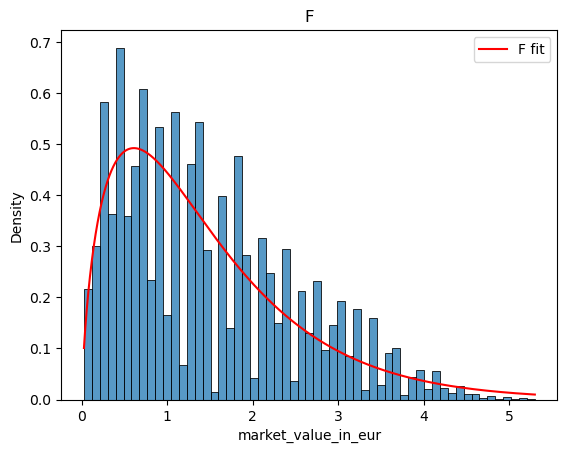

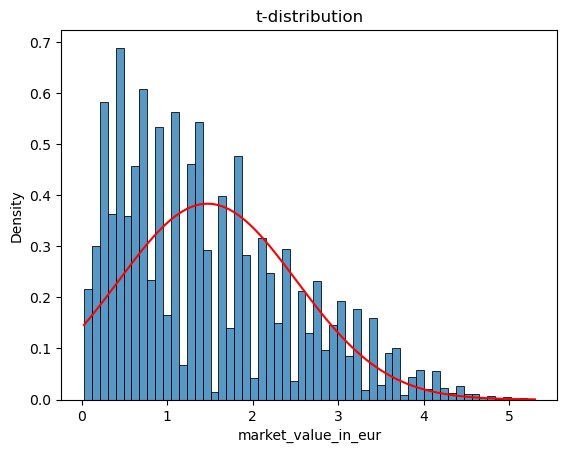

In [51]:
scaled = per_season.copy()
scaled['market_value_in_eur'] = np.log1p(per_season['market_value_in_eur']/1000000)

target_col = scaled['market_value_in_eur']
print(target_col.mean(),target_col.std())
x=np.linspace(min(target_col),max(target_col),100000)
plt.figure(1)
plt.title('Johnson SB')
plt.xlabel('Log of Market Value per million EUR')
sns.histplot(data=scaled,x='market_value_in_eur',stat='density')
john = stats.johnsonsb.fit(target_col)


plt.plot(x,stats.johnsonsb.pdf(x,*john),'r-',label='Johnson SB fit')
plt.legend()

plt.figure(2)
plt.title('Normal')
sns.histplot(data=scaled,x='market_value_in_eur',stat='density')
mu,std = stats.norm.fit(target_col)
plt.plot(x,stats.norm.pdf(x,mu,std),'r-',label='normal fit')
plt.legend()

plt.figure(3)
plt.title('Log Normal')
sns.histplot(data=scaled,x='market_value_in_eur',stat='density')
shape,loc,scale = stats.lognorm.fit(target_col,floc=0)
plt.plot(x,stats.lognorm.pdf(x,shape,loc,scale),'r-',label='log normal fit')
plt.legend()

plt.figure(4)
plt.title('F')
sns.histplot(data=scaled,x='market_value_in_eur',stat='density')
f = stats.f.fit(target_col,floc=0)
plt.plot(x,stats.f.pdf(x,*f),'r-',label='F fit')
plt.legend()

plt.figure(5)
plt.title('t-distribution')
sns.histplot(data=scaled,x='market_value_in_eur',stat='density')
t = stats.t.fit(target_col)
plt.plot(x,stats.t.pdf(x,*t),'r-',label='t-fit')
plt.show()

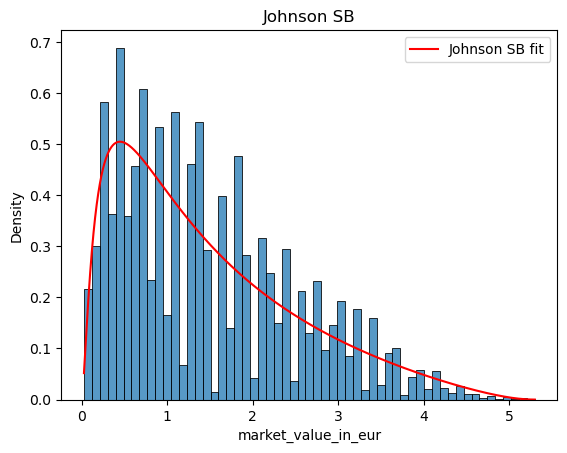

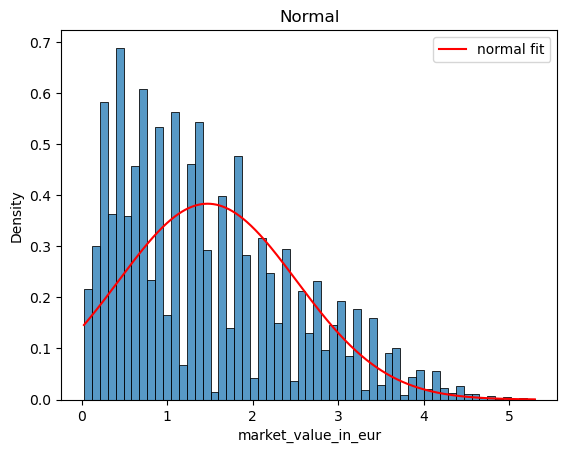

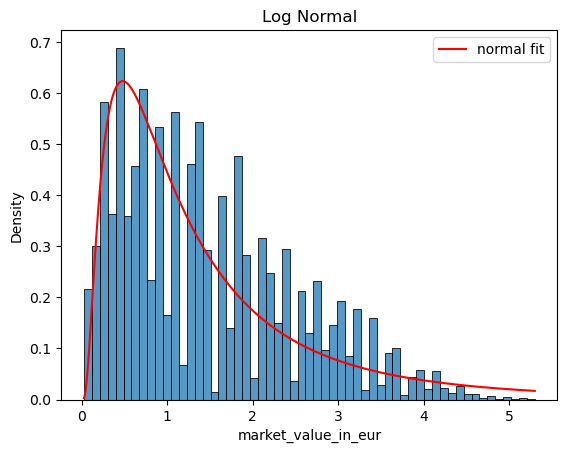

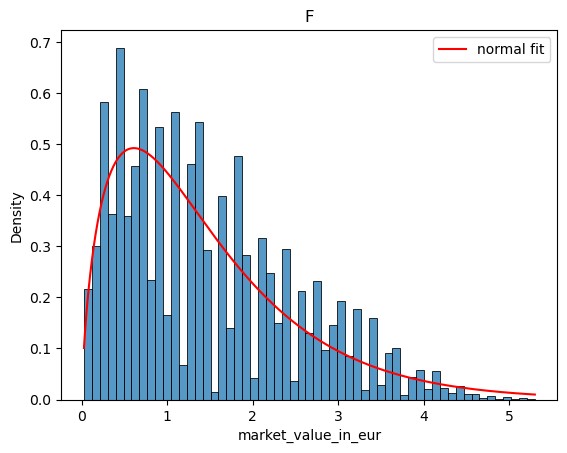

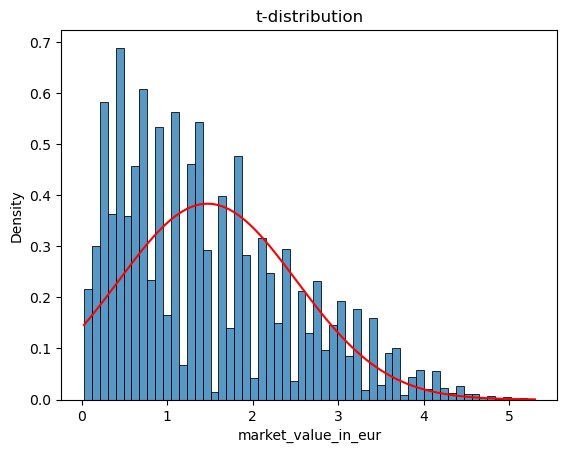

In [52]:
# The data is so extreme, lets take out the outliers

reject = reject_outliers(scaled,'market_value_in_eur',m=3)
target_col = reject['market_value_in_eur']
x=np.linspace(min(target_col),max(target_col),100000)
plt.figure(1)
plt.title('Johnson SB')
sns.histplot(data=reject,x='market_value_in_eur',stat='density')
john = stats.johnsonsb.fit(target_col)

plt.plot(x,stats.johnsonsb.pdf(x,*john),'r-',label='Johnson SB fit')
plt.legend()

plt.figure(2)
plt.title('Normal')
sns.histplot(data=reject,x='market_value_in_eur',stat='density')
mu,std = stats.norm.fit(target_col)
plt.plot(x,stats.norm.pdf(x,mu,std),'r-',label='normal fit')
plt.legend()

plt.figure(3)
plt.title('Log Normal')
sns.histplot(data=reject,x='market_value_in_eur',stat='density')
shape,loc,scale = stats.lognorm.fit(target_col,floc=0)
plt.plot(x,stats.lognorm.pdf(x,shape,loc,scale),'r-',label='normal fit')
plt.legend()

plt.figure(4)
plt.title('F')
sns.histplot(data=reject,x='market_value_in_eur',stat='density')
f = stats.f.fit(target_col,floc=0)
plt.plot(x,stats.f.pdf(x,*f),'r-',label='normal fit')
plt.legend()

plt.figure(5)
plt.title('t-distribution')
sns.histplot(data=reject,x='market_value_in_eur',stat='density')
t = stats.t.fit(target_col)
plt.plot(x,stats.t.pdf(x,*t),'r-',label='t-fit')

plt.show()

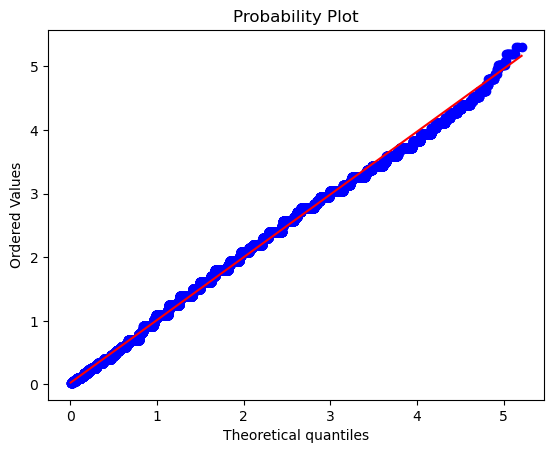

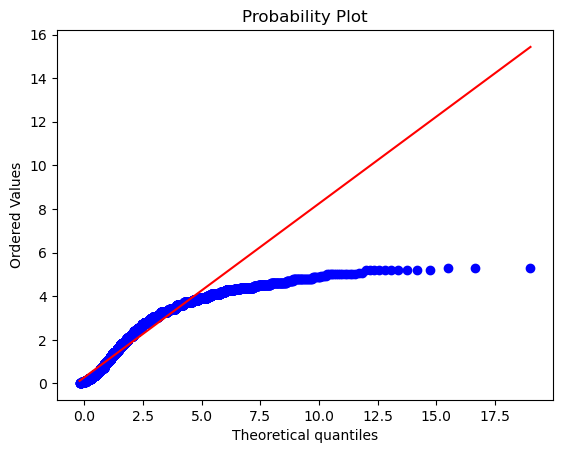

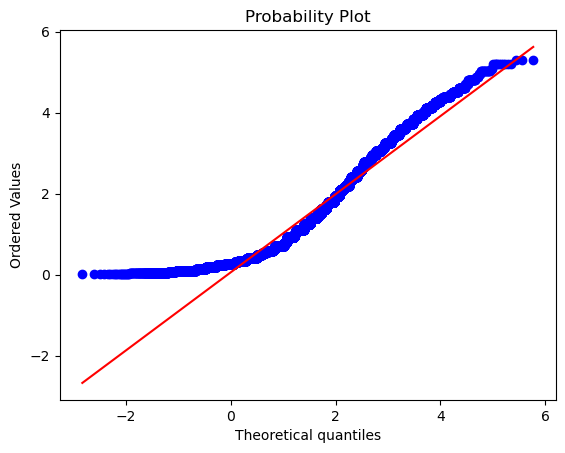

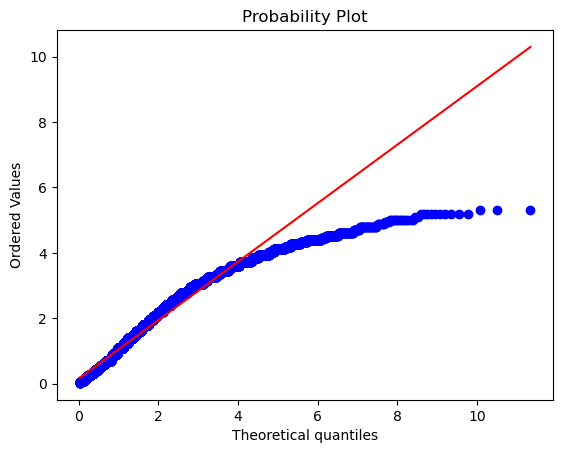

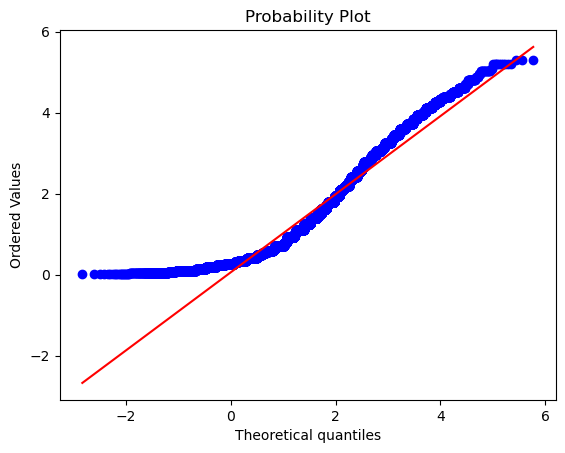

In [53]:
# get QQ plot
data = scaled['market_value_in_eur']

plt.figure(1)
plt.title('Johnson SB')
john = stats.johnsonsb.fit(data)
stats.probplot(data,dist=stats.johnsonsb,sparams=john,plot=plt)
plt.figure(2)
plt.title('Log Normal')
log_fit = stats.lognorm.fit(data)
stats.probplot(scaled['market_value_in_eur'],dist='lognorm',sparams=log_fit,plot=plt)
plt.figure(3)
plt.title('Normal')
norm_fit = stats.norm.fit(data)
stats.probplot(scaled['market_value_in_eur'],dist=stats.norm,sparams=norm_fit,plot=plt)

plt.figure(4)
plt.title('F Distribution')
f_fit = stats.f.fit(data)
stats.probplot(scaled['market_value_in_eur'],dist=stats.f,sparams=f_fit,plot=plt)

plt.figure(5)
plt.title('t Distribution')
t_fit = stats.t.fit(data)
stats.probplot(scaled['market_value_in_eur'],dist=stats.t,sparams=t_fit,plot=plt)
plt.show()

Above we can see that the Johnson SB distribution has the closest fit with our target data.

In [54]:
print(f"mean: {scaled['market_value_in_eur'].mean()}")
print(f"std: {scaled['market_value_in_eur'].std()}")
print(f"skewness: {scaled['market_value_in_eur'].skew()}")
print(f"Kurtosis: {scaled['market_value_in_eur'].kurt()}")
a,b,loc,scale = stats.johnsonsb.fit(scaled['market_value_in_eur'])
print(a,b,loc,scale)

mean: 1.4718235520313585
std: 1.041440600779309
skewness: 0.7629695168315419
Kurtosis: -0.17845100791069823
1.0407719968871658 0.8497448536312125 -0.009769682465053138 5.354675258766138


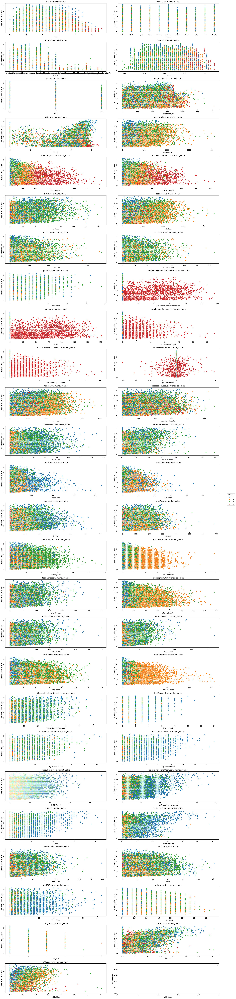

In [55]:
fig,axes = plt.subplots(ncols=2,nrows = int(len(g_stats)/2)+1,figsize=(20,90))
axes = axes.flatten()

for i, gs in enumerate(g_stats):
    
    sns.scatterplot(data=scaled,x=gs,y='market_value_in_eur',hue='position_acronym',ax=axes[i])
    axes[i].set_title(f'{gs} vs market_value')
    axes[i].legend().remove()
    plt.xlabel(gs)
    plt.ylabel('market_value')

handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1.02, 0.5), title='Positions')
plt.tight_layout()
plt.legend()
plt.show()

In [56]:
scaled.columns

Index(['minutesPlayed', 'totalLongBalls', 'keyPass', 'accuratePass',
       'totalPass', 'totalCross', 'savedShotsFromInsideTheBox', 'saves',
       'totalKeeperSweeper', 'goalsPrevented', 'touches', 'possessionLostCtrl',
       'dispossessed', 'goalAssist', 'aerialWon', 'aerialLost', 'duelLost',
       'duelWon', 'challengeLost', 'outfielderBlock', 'totalContest',
       'interceptionWon', 'accurateCross', 'accurateKeeperSweeper',
       'accurateLongBalls', 'wonContest', 'totalTackle', 'totalClearance',
       'blockedScoringAttempt', 'hitWoodwork', 'bigChanceCreated',
       'bigChanceMissed', 'shotOffTarget', 'onTargetScoringAttempt', 'goals',
       'wasFouled', 'fouls', 'totalOffside', 'yellow_card', 'red_card',
       'expectedGoals', 'expectedAssists', 'rating', 'xGChain', 'xGBuildup',
       'market_value_in_eur', 'position_acronym', 'league', 'season', 'team',
       'date', 'date_of_birth_ss', 'height', 'foot', 'age'],
      dtype='object')

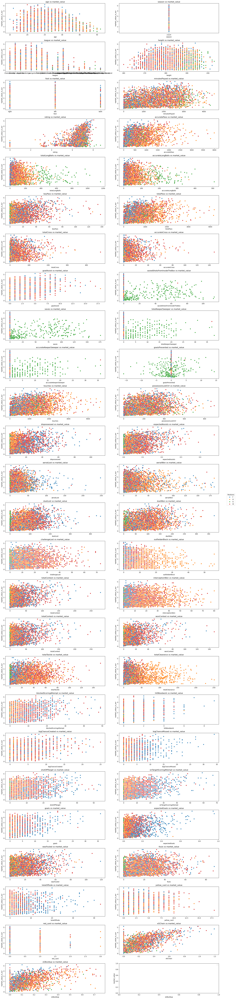

In [57]:
# Lets do the same above, but with just fowards
fig,axes = plt.subplots(ncols=2,nrows = int(len(g_stats)/2)+1,figsize=(20,90))
axes = axes.flatten()

team_scaled = scaled[(scaled['season'] == '23/24')]
for i, gs in enumerate(g_stats):
    
    sns.scatterplot(data=team_scaled,x=gs,y='market_value_in_eur',hue='position_acronym',ax=axes[i])
    axes[i].set_title(f'{gs} vs market_value')
    axes[i].legend().remove()
    plt.xlabel(gs)
    plt.ylabel('market_value')

handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1.02, 0.5), title='Positions')
plt.tight_layout()
plt.legend()
plt.show()

[]

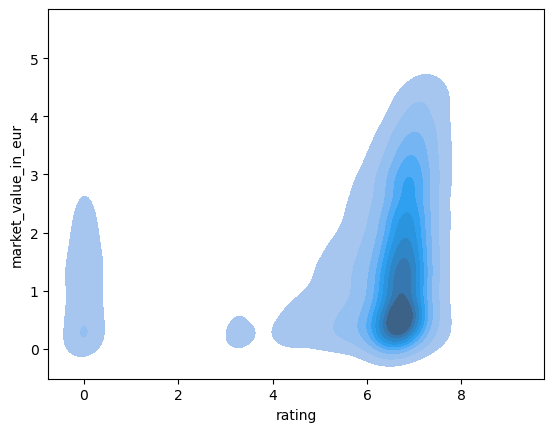

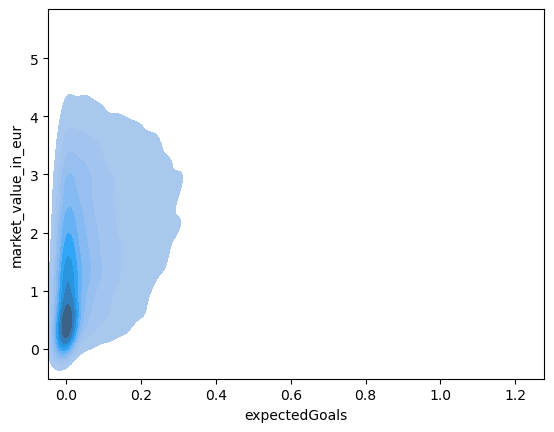

In [58]:
plt.figure(1)
sns.kdeplot(scaled,x='rating',y='market_value_in_eur',fill=True)

plt.figure(2)
sns.kdeplot(scaled,x='expectedGoals',y='market_value_in_eur',fill=True)
plt.plot()

### Analysis of Quantitative Variables

In [59]:
def getNumericColumns(data):
    quantiative = [f for f in data.columns if data.dtypes[f] !='object']
    return quantiative

In [60]:
quant_vars = getNumericColumns(scaled)
quant_vars.remove('date')
quant_vars.remove('date_of_birth_ss')
quant_vars

['minutesPlayed',
 'totalLongBalls',
 'keyPass',
 'accuratePass',
 'totalPass',
 'totalCross',
 'savedShotsFromInsideTheBox',
 'saves',
 'totalKeeperSweeper',
 'goalsPrevented',
 'touches',
 'possessionLostCtrl',
 'dispossessed',
 'goalAssist',
 'aerialWon',
 'aerialLost',
 'duelLost',
 'duelWon',
 'challengeLost',
 'outfielderBlock',
 'totalContest',
 'interceptionWon',
 'accurateCross',
 'accurateKeeperSweeper',
 'accurateLongBalls',
 'wonContest',
 'totalTackle',
 'totalClearance',
 'blockedScoringAttempt',
 'hitWoodwork',
 'bigChanceCreated',
 'bigChanceMissed',
 'shotOffTarget',
 'onTargetScoringAttempt',
 'goals',
 'wasFouled',
 'fouls',
 'totalOffside',
 'yellow_card',
 'red_card',
 'expectedGoals',
 'expectedAssists',
 'rating',
 'xGChain',
 'xGBuildup',
 'market_value_in_eur',
 'height',
 'age']

In [61]:
#normality test
stat , p=stats.shapiro(scaled[quant_vars])
print(f'Statistics = {stat}, p={p}')
alpha = 0.05
if p<alpha:
    print(f'Sample looks Gaussian (fail to reject H0)')
else:
    print(f'Sample does not look Gaussian (reject H0)')

Statistics = 0.2788314194203131, p=6.686347578917641e-233
Sample looks Gaussian (fail to reject H0)


### Visualizing Normality

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

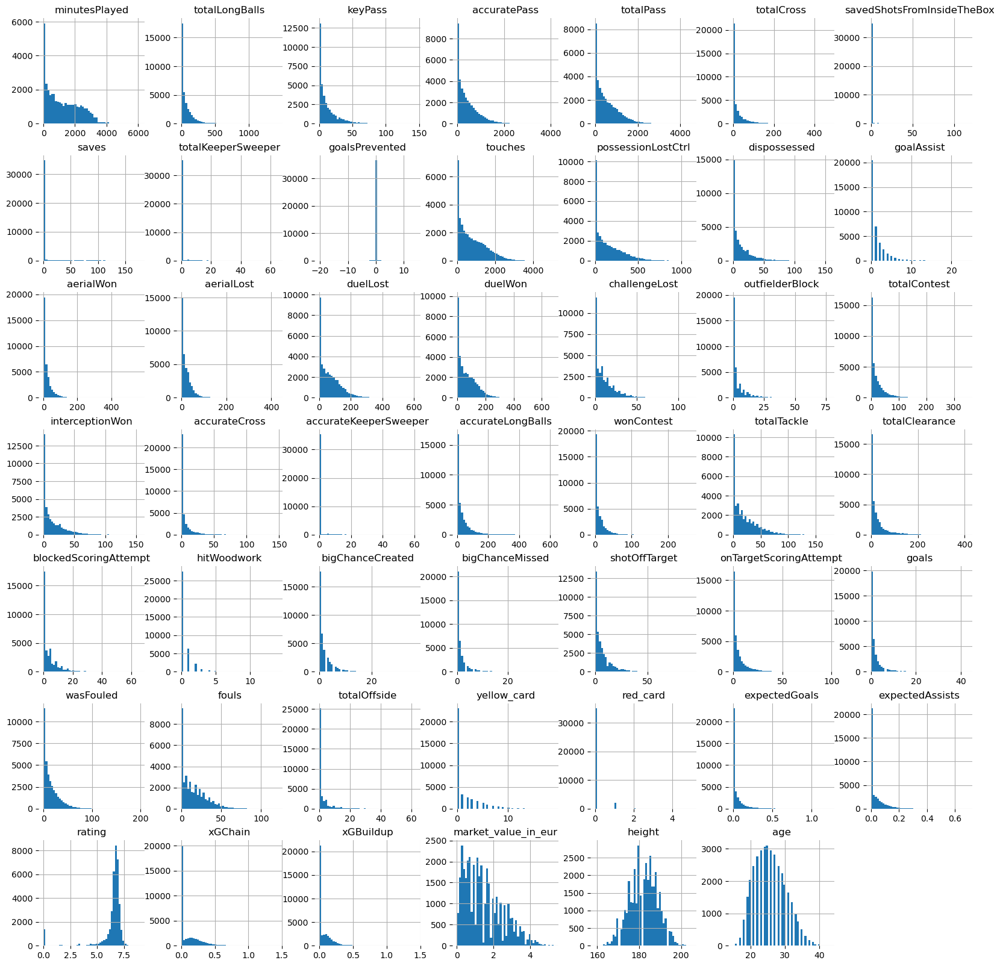

In [62]:
df = scaled[quant_vars]
h = df.hist(bins=50,figsize=(20,20),xlabelsize='10',ylabelsize='10',xrot=-.15)
sns.despine(left=True,bottom=True)
[x.title.set_size(12) for x in h.ravel()]
[x.yaxis.tick_left() for x in h.ravel()]

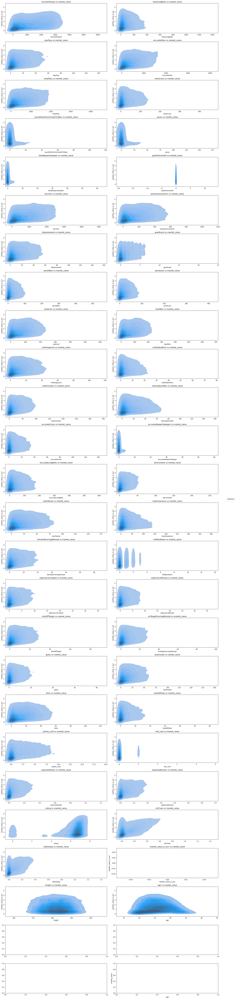

In [63]:
fig,axes = plt.subplots(ncols=2,nrows = int(len(g_stats)/2)+1,figsize=(20,90))
axes = axes.flatten()

for i, gs in enumerate(quant_vars):
    
    sns.kdeplot(data=scaled,x=gs,y='market_value_in_eur',fill=True,ax=axes[i])
    axes[i].set_title(f'{gs} vs market_value')
    axes[i].legend().remove()
    plt.xlabel(gs)
    plt.ylabel('market_value')

handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1.02, 0.5), title='Positions')
plt.tight_layout()
plt.legend()
plt.show()

<Axes: >

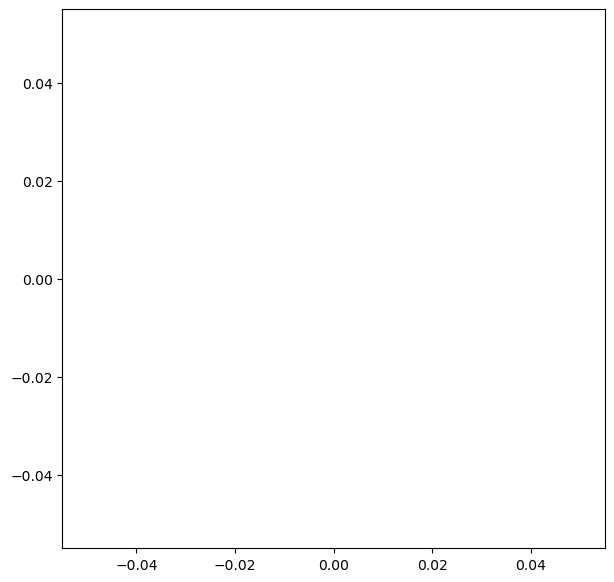

In [64]:
# Lets look at the distribution of the ratings

plt.figure(figsize=(7,7))
sns.histplot()

Seems like everything here is following some sort of Johnson SB distribution.

### Outlier Analysis

In [65]:
df = scaled
target = 'market_value_in_eur'

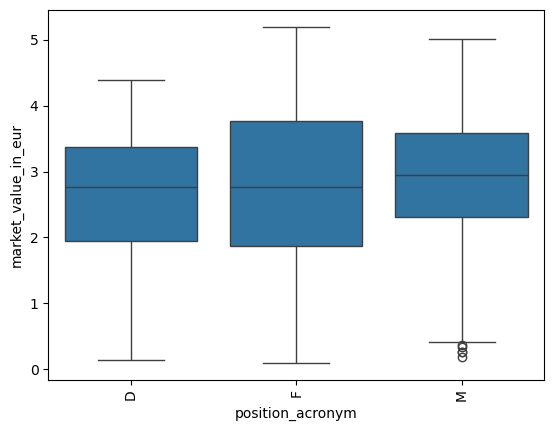

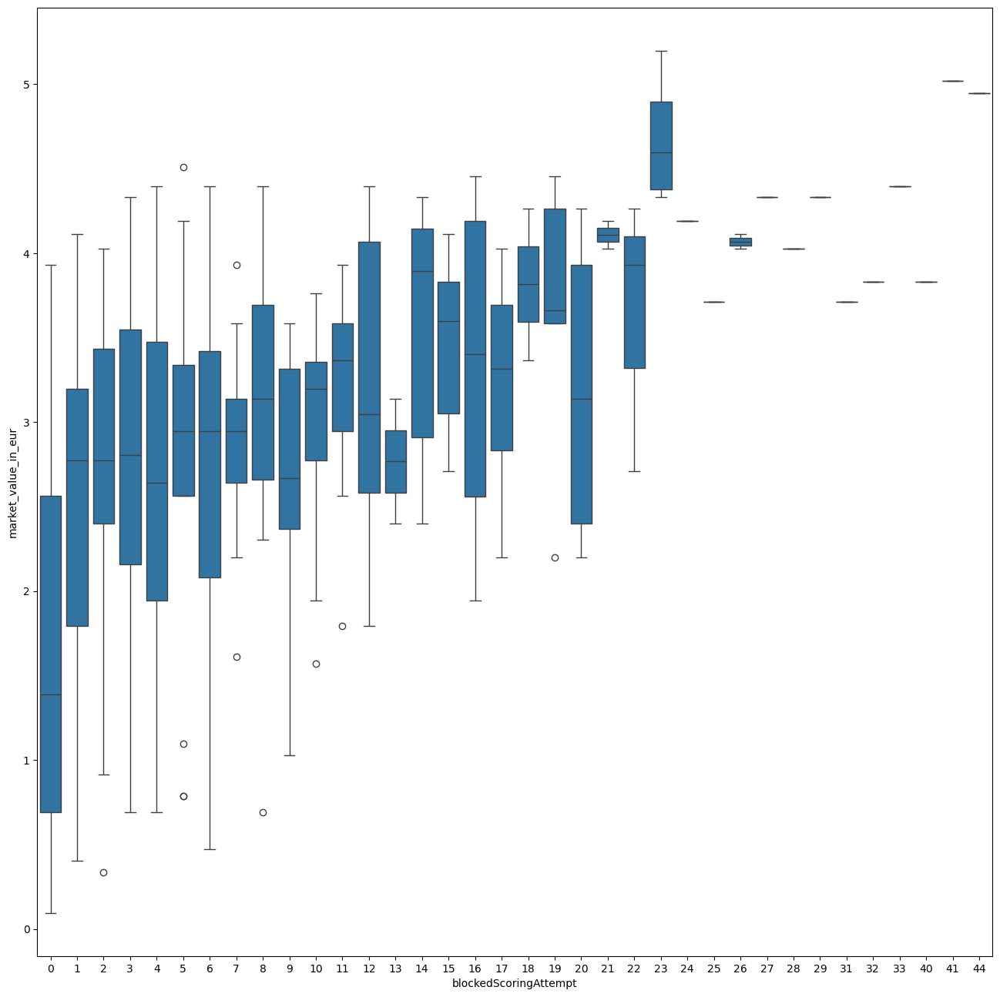

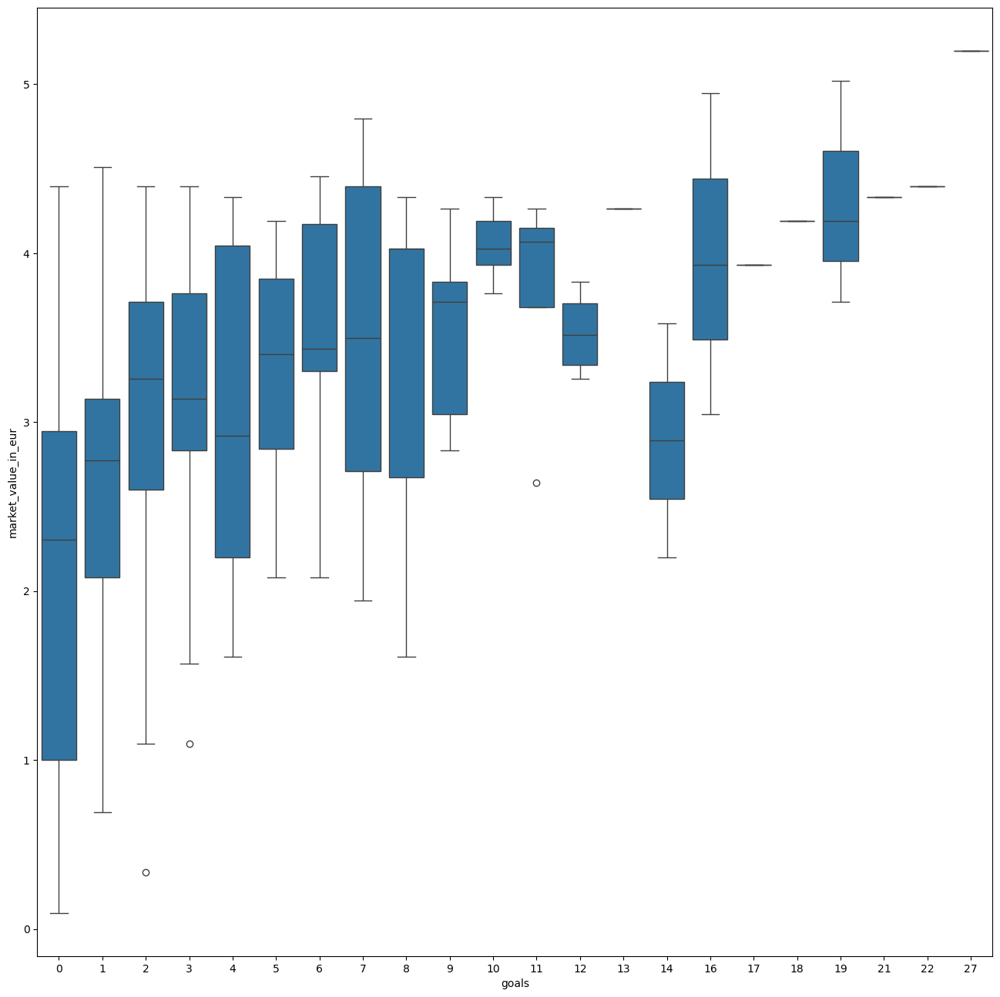

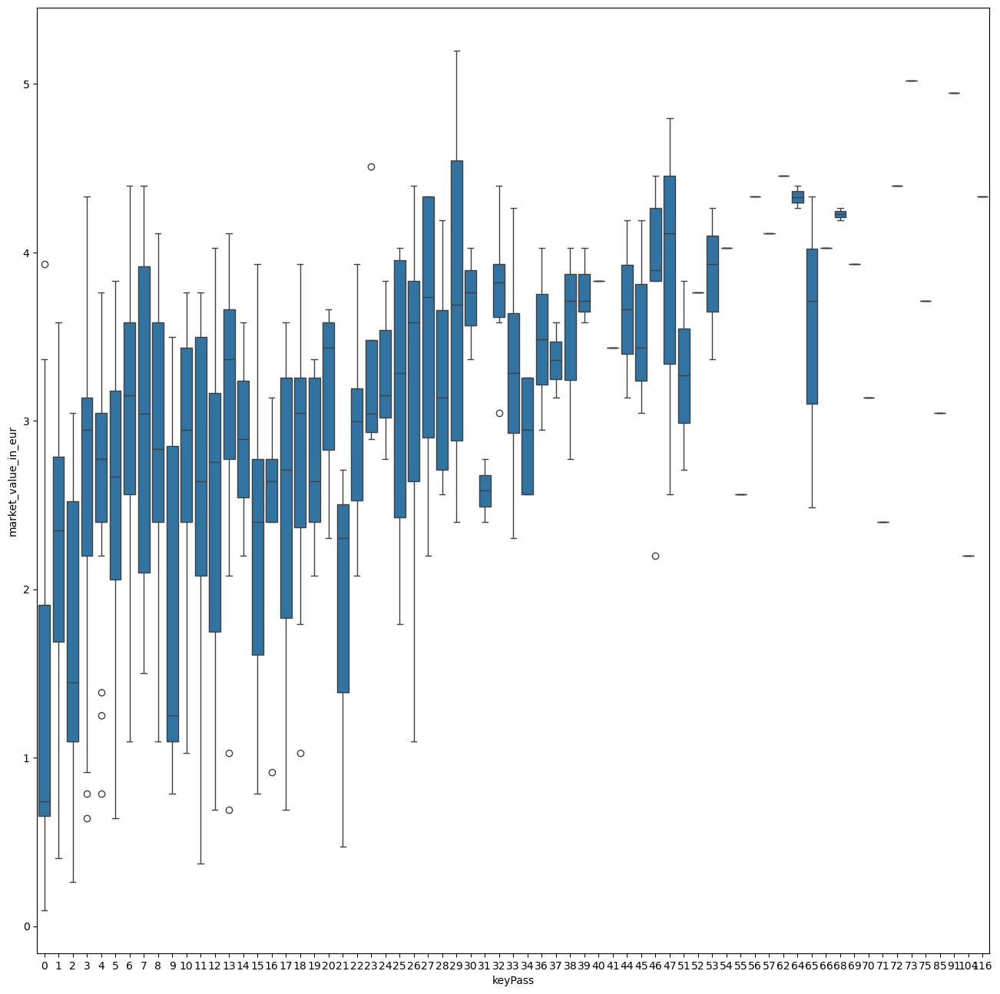

In [66]:
df = scaled[(scaled['season'] == '23/24') & (scaled['position_acronym'] !='G') & (scaled['league'] == 'Premier League')]
#df=scaled
plt.figure(1)

sns.boxplot(x=df['position_acronym'],y=df[target])
plt.xticks(rotation=90)

plt.figure(2,figsize=(16,16))
sns.boxplot(x=df['blockedScoringAttempt'],y=df[target])

plt.figure(3,figsize=(16,16))
sns.boxplot(x=df['goals'],y=df[target])

plt.figure(4,figsize=(16,16))
sns.boxplot(x=df['keyPass'],y=df[target])

plt.show()


### Correlation

<Axes: title={'center': 'Pearson Correlation Matrix'}>

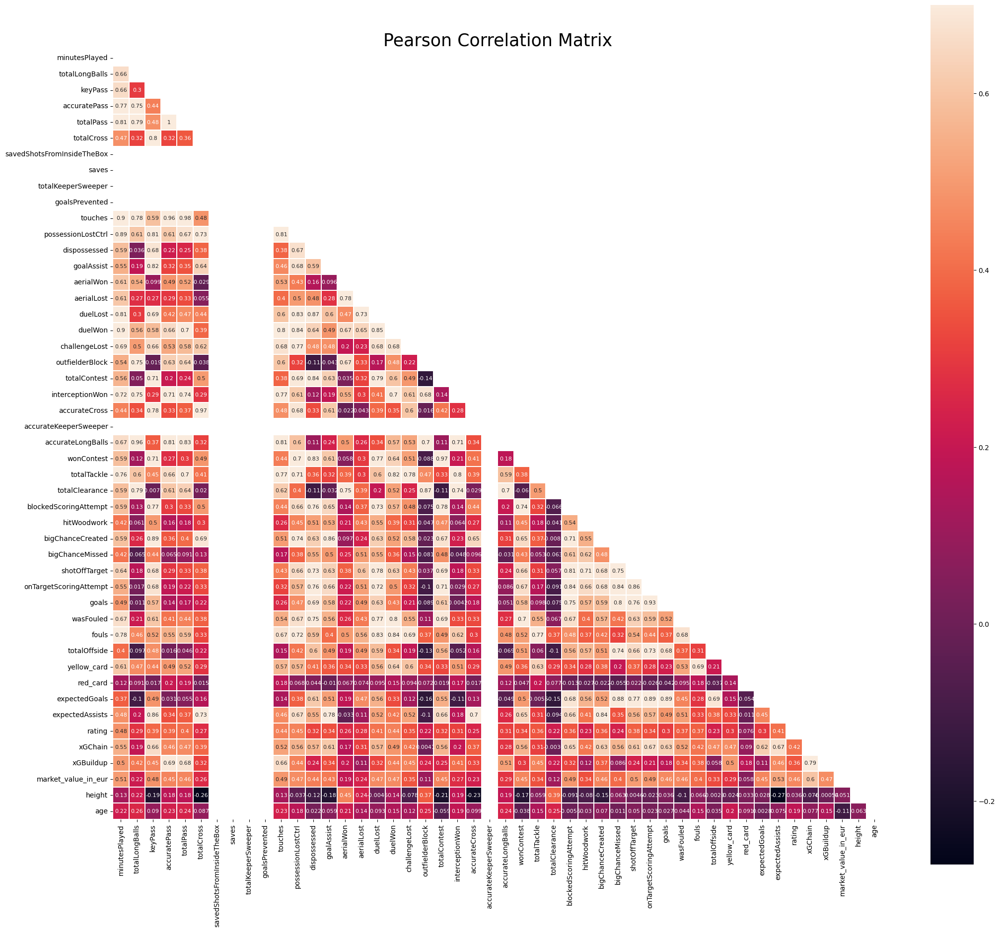

In [67]:
features = quant_vars
mask = np.zeros_like(df[features].corr(),dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

f,ax = plt.subplots(figsize=(25,25))
plt.title('Pearson Correlation Matrix',fontsize=25)

sns.heatmap(df[features].corr(),linewidths=0.25,vmax=0.7,square=True,linecolor='w',annot=True,annot_kws={'size':8},
            mask=mask,cbar_kws={'shrink':.9})